In [1]:
# --- AI SPY: Intelligent Image Caption Generator ---

# Import essential libraries
from transformers import BlipProcessor, BlipForConditionalGeneration
from PIL import Image
import requests
import torch

# Check if GPU is available (for speed)
device = "cuda" if torch.cuda.is_available() else "cpu"
print("Running on:", device)


Running on: cpu


In [2]:
# Load pre-trained BLIP model and processor
from transformers import BlipProcessor, BlipForConditionalGeneration

processor = BlipProcessor.from_pretrained("Salesforce/blip-image-captioning-base")
model = BlipForConditionalGeneration.from_pretrained("Salesforce/blip-image-captioning-base").to(device)

print("✅ Model loaded successfully!")


Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


✅ Model loaded successfully!


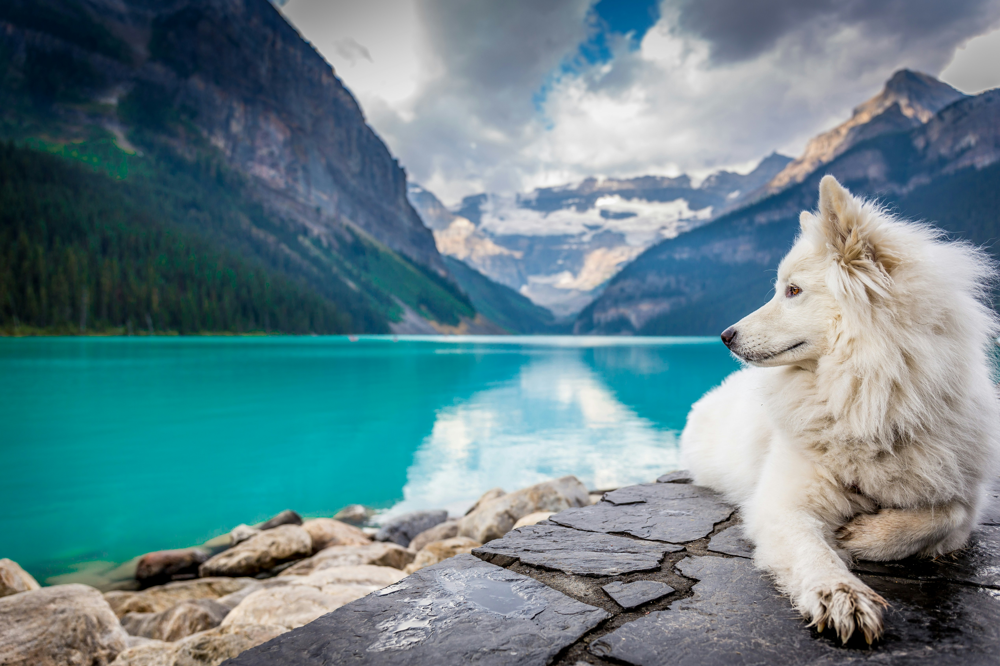

📝 Generated Caption: a white dog sitting on a rock near a lake


In [3]:
from PIL import Image
import requests
from IPython.display import display

# Test with an online image
image_url = "https://images.unsplash.com/photo-1504208434309-cb69f4fe52b0"  # You can replace this with any image link
image = Image.open(requests.get(image_url, stream=True).raw)

# Display the image
display(image)

# Process and generate caption
inputs = processor(image, return_tensors="pt").to(device)
out = model.generate(**inputs)

# Decode and print caption
caption = processor.decode(out[0], skip_special_tokens=True)
print("📝 Generated Caption:", caption)


In [ ]:
from transformers import pipeline

# Use a smarter, instruction-tuned model
generator = pipeline(
    "text-generation",
    model="microsoft/phi-2",   # much better at following prompts
    trust_remote_code=True,
    device_map="auto"
)

# 🖼️ Example caption (from your image model)
caption = "a long road with a mountain in the background"

# --- HEADLINE ---
headline_prompt = f"""
You are a witty marketing copywriter.
Write a catchy, emotional headline (under 10 words) for this image caption:
'{caption}'
Make it sound inspiring and adventurous.
"""

# --- SOCIAL CAPTION ---
social_prompt = f"""
You are a creative Instagram copywriter.
Write a fun, viral caption for this image: '{caption}'
Add 2-3 relevant emojis and 2 trendy hashtags.
Make it sound youthful and energetic, under 25 words.
"""

# --- GENERATE ---
headline = generator(headline_prompt, max_new_tokens=60, do_sample=True, temperature=0.8)[0]['generated_text']
social_caption = generator(social_prompt, max_new_tokens=60, do_sample=True, temperature=0.9)[0]['generated_text']

print("\n📰 Headline:", headline)
print("\n📱 Social Caption:", social_caption)




config.json:   0%|          | 0.00/735 [00:00<?, ?B/s]

C:\Users\Dell\anaconda3\envs\ai_spy\lib\site-packages\huggingface_hub\file_download.py:143: UserWarning: `huggingface_hub` cache-system uses symlinks by default to efficiently store duplicated files but your machine does not support them in C:\Users\Dell\.cache\huggingface\hub\models--microsoft--phi-2. Caching files will still work but in a degraded version that might require more space on your disk. This warning can be disabled by setting the `HF_HUB_DISABLE_SYMLINKS_WARNING` environment variable. For more details, see https://huggingface.co/docs/huggingface_hub/how-to-cache#limitations.
To support symlinks on Windows, you either need to activate Developer Mode or to run Python as an administrator. In order to activate developer mode, see this article: https://docs.microsoft.com/en-us/windows/apps/get-started/enable-your-device-for-development
  warnings.warn(message)


model.safetensors.index.json: 0.00B [00:00, ?B/s]

Fetching 2 files:   0%|          | 0/2 [00:00<?, ?it/s]

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`
Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


model-00002-of-00002.safetensors:   0%|          | 0.00/564M [00:00<?, ?B/s]

model-00001-of-00002.safetensors:   0%|          | 0.00/5.00G [00:00<?, ?B/s]

In [ ]:
from transformers import MarianMTModel, MarianTokenizer

# Translate English captions to another language (e.g., Hindi)
src_text = [caption]
tokenizer = MarianTokenizer.from_pretrained("Helsinki-NLP/opus-mt-en-hi")
model_trans = MarianMTModel.from_pretrained("Helsinki-NLP/opus-mt-en-hi")

translated = model_trans.generate(**tokenizer(src_text, return_tensors="pt", padding=True))
hindi_caption = tokenizer.decode(translated[0], skip_special_tokens=True)

print("\n🌐 Hindi Caption:", hindi_caption)


In [ ]:
!pip install sentencepiece

In [ ]:
from transformers import MarianMTModel, MarianTokenizer

# Translate English caption to Hindi
src_text = [caption]
tokenizer = MarianTokenizer.from_pretrained("Helsinki-NLP/opus-mt-en-hi")
model_trans = MarianMTModel.from_pretrained("Helsinki-NLP/opus-mt-en-hi")

translated = model_trans.generate(**tokenizer(src_text, return_tensors="pt", padding=True))
hindi_caption = tokenizer.decode(translated[0], skip_special_tokens=True)

print("\n🌐 Hindi Caption:", hindi_caption)


In [ ]:
# --- TEST 2: Marketing-oriented caption generation ---

# Example image URL
image_url = "https://images.unsplash.com/photo-1500530855697-b586d89ba3ee"

# Load and display the image
from PIL import Image
import requests
image = Image.open(requests.get(image_url, stream=True).raw)
display(image)

# Generate base caption (using your BLIP model)
inputs = processor(image, return_tensors="pt").to(device)
out = model.generate(**inputs)
caption = processor.decode(out[0], skip_special_tokens=True)
print("\n🖼️ Base Caption:", caption)

# --- Marketing-style headline & social caption ---
from transformers import pipeline

generator = pipeline("text-generation", model="distilgpt2")


headline_prompt = f"""
You are a creative marketing AI that writes headlines like a brand strategist.
Write a short, scroll-stopping headline for this image caption:
'{caption}'
Make it sound inspiring and motivational.
"""

social_prompt = f"""
You are a social media marketing copywriter.
Write a viral Instagram caption for this image: '{caption}'
- Use emojis naturally
- Add 2–3 trending hashtags
- Use an uplifting tone (e.g., adventure, nature, freedom)
- Add a small call-to-action like “Tag your travel buddy!”
"""

headline = generator(headline_prompt, max_length=50, num_return_sequences=1)[0]['generated_text']
social_c_
